<a href="https://colab.research.google.com/github/klordo/deep_gen_models_hws/blob/hw4/gen_hw4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from transformers import CLIPTextModel, CLIPTokenizer
from diffusers import AutoencoderKL, StableDiffusionPipeline, UNet2DConditionModel, DDPMScheduler
from diffusers import DPMSolverMultistepScheduler
from diffusers import EulerAncestralDiscreteScheduler
import torch

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"
dtype=torch.float16
device

'cuda'

# Convert model

Веса были скачаны локально через командную строку

In [ ]:
!python C:/Users/Klim/diffusers/scripts/convert_original_stable_diffusion_to_diffusers.py \
    --checkpoint_path=C:/Users/Klim/civitai_midel.ckpt \
    --original_config_file=C:/Users/Klim/v1-inference.yaml \
    --dump_path=C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/civitai_model \
    --scheduler_type="ddim" --prediction_type=epsilon \
    --from_safetensors

C:\anaconda\envs\pytorch-gpu-python-3-10\lib\site-packages\transformers\utils\generic.py:311: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(
C:\anaconda\envs\pytorch-gpu-python-3-10\lib\site-packages\transformers\utils\generic.py:311: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.
C:\anaconda\envs\pytorch-gpu-python-3-10\

# Train Stable diffusion 1.5

In [ ]:
!python C:/Users/Klim/diffusers/examples/dreambooth/train_dreambooth.py \
    --pretrained_model_name_or_path=C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/civitai_model \
    --instance_data_dir=C:/Users/Klim/Documents/Gen_models_HW_4/cropped_images \
    --class_data_dir=C:/Users/Klim/Documents/Gen_models_HW_4/class_images_2 \
    --output_dir=C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/civitai_model/dreambooth/experiment_2 \
    --instance_prompt="a photo of sks woman face" \
    --class_prompt="a photo of woman face " \
    --with_prior_preservation --prior_loss_weight=1.0 \
    --resolution=512 --train_batch_size=1 --learning_rate=2e-6 \
    --lr_scheduler="constant" --lr_warmup_steps=0 --gradient_accumulation_steps=1 \
    --num_class_images=500 --max_train_steps=800 --checkpointing_steps=800 --use_8bit_adam \
    --mixed_precision="no" --train_text_encoder

C:\anaconda\envs\pytorch-gpu-python-3-10\lib\site-packages\transformers\utils\generic.py:311: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(
C:\anaconda\envs\pytorch-gpu-python-3-10\lib\site-packages\accelerate\accelerator.py:383: UserWarning: `log_with=tensorboard` was passed but no supported trackers are currently installed.
  warnings.warn(f"`log_with={log_with}` was passed but no supported trackers are currently installed.")
04/11/2024 07:58:51 - INFO - __main__ - Distributed environment: NO
Num processes: 1
Process index: 0
Local process index: 0
Device: cuda

Mixed precision type: no


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]Loaded tokenizer as CLIPTokenizer from `tokenizer` subfolder of C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/civitai_model.

Loading pipeline components...:  17%|#6        | 1/6 [00:00<00:00,

## Inference

In [ ]:
from torch import autocast
from diffusers import StableDiffusionPipeline, DDIMScheduler
from IPython.display import display
import os

In [ ]:
model_path = 'C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/civitai_model/dreambooth/experiment_2'

pipe = StableDiffusionPipeline.from_pretrained(model_path, safety_checker=None, torch_dtype=torch.float16).to("cuda")
pipe.scheduler = DDIMScheduler.from_config(pipe.scheduler.config)
g_cuda=None

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

C:\anaconda\envs\pytorch-gpu-python-3-10\lib\site-packages\transformers\models\clip\feature_extraction_clip.py:28: FutureWarning: The class CLIPFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use CLIPImageProcessor instead.
  warnings.warn(
You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


In [ ]:
#@markdown Can set random seed here for reproducibility.
g_cuda = torch.Generator(device='cuda')
seed = 345252
g_cuda.manual_seed(seed)

  0%|          | 0/30 [00:00<?, ?it/s]

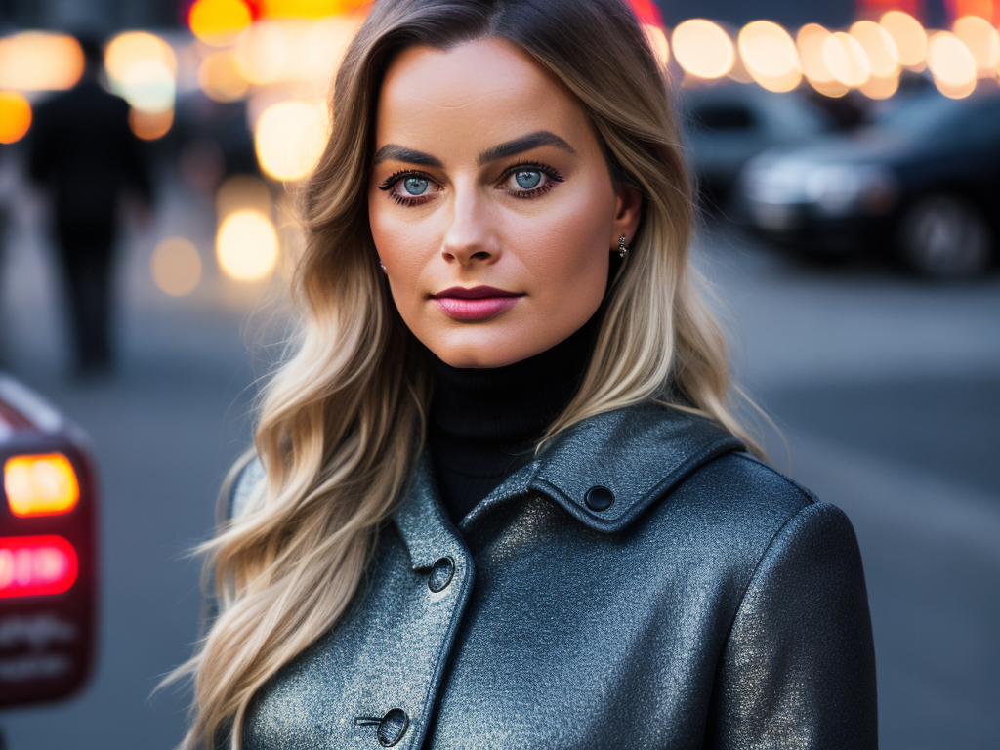

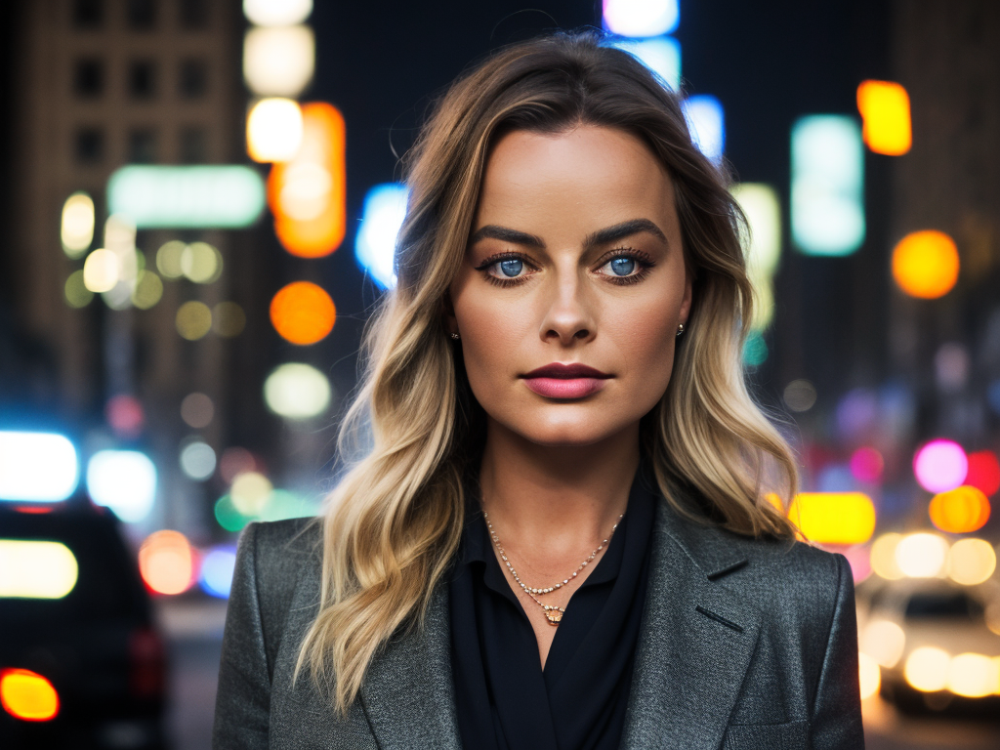

In [ ]:
prompt = "portrait of sks woman face, on the street, lights, midnight, NY, standing, raw, hd, high quality, realism, detailed light eyes"
negative_prompt = "naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands disconnected limbs, mutation, ugly, blurry, amputation"
num_samples = 2
guidance_scale = 7.5
num_inference_steps = 30
height = 768
width = 1024

with autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        negative_prompt=negative_prompt,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    ).images

for img in images:
    display(img)

In [ ]:
report_dir = 'report_images'
for i in range(len(images)):
    images[i].save(os.path.join(report_dir, f"{i}.jpg"))


Получилось достаточно похоже на изображения из обучающего датасета. Интересно, что при добавлении имени актрисы в промт изображение становится несколько карикатурным, с гипертрофированными чертами.

  0%|          | 0/30 [00:00<?, ?it/s]

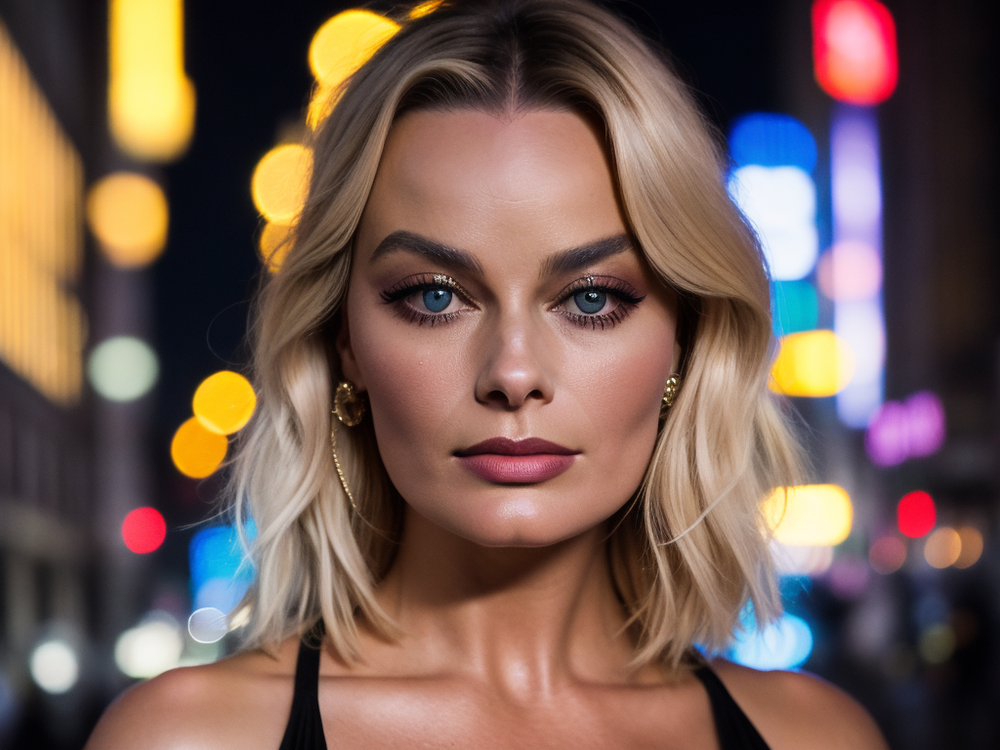

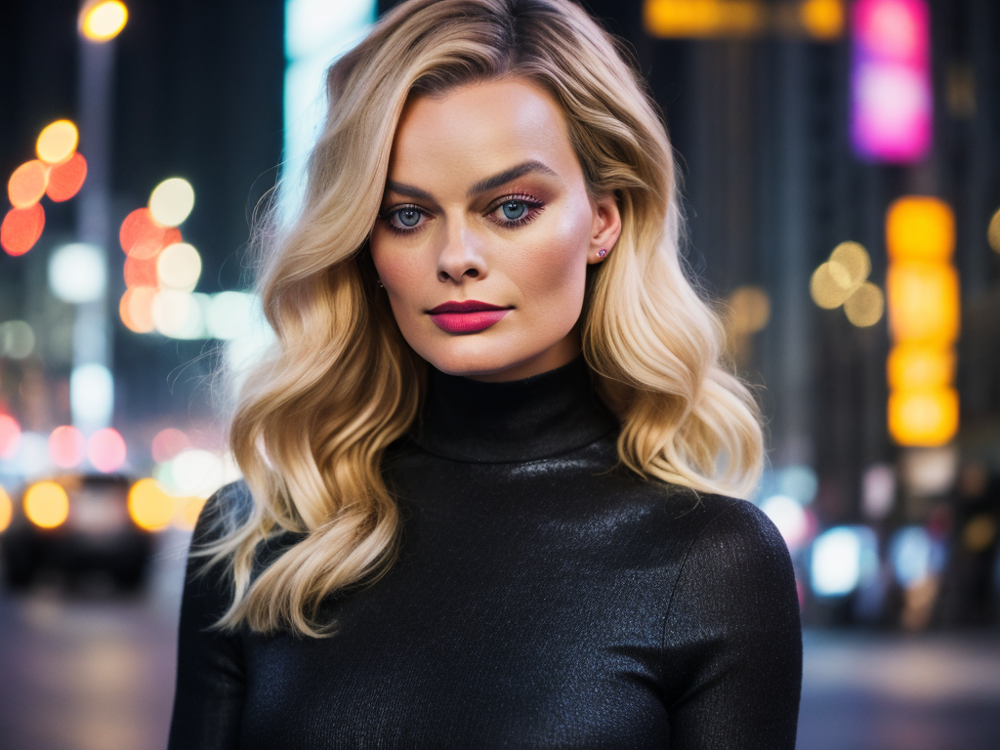

In [ ]:
prompt = "portrait of sks woman face, Margo Robbie, on the street, lights, midnight, NY, standing, raw, hd, high quality, realism, detailed light eyes"
negative_prompt = "naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands disconnected limbs, mutation, ugly, blurry, amputation"
num_samples = 2
guidance_scale = 7.5
num_inference_steps = 30
height = 768
width = 1024

with autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        negative_prompt=negative_prompt,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    ).images

for img in images:
    display(img)

# Train  LoRA

rank = 2

Experiment 1

In [ ]:
!python C:/Users/Klim/diffusers/examples/dreambooth/train_dreambooth_lora.py \
    --pretrained_model_name_or_path=C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/civitai_model \
    --instance_data_dir=C:/Users/Klim/Documents/Gen_models_HW_4/cropped_images \
    --class_data_dir=C:/Users/Klim/Documents/Gen_models_HW_4/class_images \
    --output_dir=C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/lora_exp/experiment_1 \
    --instance_prompt="a photo of sks woman face" --class_prompt="a photo of woman face " \
    --with_prior_preservation --prior_loss_weight=1.0 --resolution=512 --train_batch_size=1 \
    --learning_rate=2e-6 --lr_scheduler="constant" --lr_warmup_steps=0 --gradient_accumulation_steps=1 \
    --num_class_images=500 --max_train_steps=800 --checkpointing_steps=800 --use_8bit_adam --mixed_precision="no" \
    --rank=2 --train_text_encoder

C:\anaconda\envs\pytorch-gpu-python-3-10\lib\site-packages\accelerate\accelerator.py:383: UserWarning: `log_with=tensorboard` was passed but no supported trackers are currently installed.
  warnings.warn(f"`log_with={log_with}` was passed but no supported trackers are currently installed.")
04/12/2024 18:22:57 - INFO - __main__ - Distributed environment: NO
Num processes: 1
Process index: 0
Local process index: 0
Device: cuda

Mixed precision type: no


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]Loaded text_encoder as CLIPTextModel from `text_encoder` subfolder of C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/civitai_model.

Loading pipeline components...:  17%|#6        | 1/6 [00:00<00:03,  1.35it/s]Loaded tokenizer as CLIPTokenizer from `tokenizer` subfolder of C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/civitai_model.

Loading pipeline components...:  33%|###3      | 2/6 [00:00<00:01,  2.64it/s]Loaded unet as UNet2DConditionModel fro

rank = 4

Experiment 2

In [ ]:
!python C:/Users/Klim/diffusers/examples/dreambooth/train_dreambooth_lora.py \
    --pretrained_model_name_or_path=C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/civitai_model \
    --instance_data_dir=C:/Users/Klim/Documents/Gen_models_HW_4/cropped_images \
    --class_data_dir=C:/Users/Klim/Documents/Gen_models_HW_4/class_images \
    --output_dir=C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/lora_exp/experiment_2 \
    --instance_prompt="a photo of sks woman face" --class_prompt="a photo of woman face " --with_prior_preservation \
    --prior_loss_weight=1.0 --resolution=512 --train_batch_size=1 --learning_rate=2e-6 --lr_scheduler="constant" \
    --lr_warmup_steps=0 --gradient_accumulation_steps=1 --num_class_images=500 --max_train_steps=800 \
    --checkpointing_steps=800 --use_8bit_adam --mixed_precision="no" --rank=4 --train_text_encoder

C:\anaconda\envs\pytorch-gpu-python-3-10\lib\site-packages\accelerate\accelerator.py:383: UserWarning: `log_with=tensorboard` was passed but no supported trackers are currently installed.
  warnings.warn(f"`log_with={log_with}` was passed but no supported trackers are currently installed.")
04/12/2024 18:55:38 - INFO - __main__ - Distributed environment: NO
Num processes: 1
Process index: 0
Local process index: 0
Device: cuda

Mixed precision type: no

You are using a model of type clip_text_model to instantiate a model of type . This is not supported for all configurations of models and can yield errors.
{'variance_type'} was not found in config. Values will be initialized to default values.
04/12/2024 18:55:45 - INFO - __main__ - ***** Running training *****
04/12/2024 18:55:45 - INFO - __main__ -   Num examples = 500
04/12/2024 18:55:45 - INFO - __main__ -   Num batches each epoch = 500
04/12/2024 18:55:45 - INFO - __main__ -   Num Epochs = 2
04/12/2024 18:55:45 - INFO - __main__ - 

Experiment 8

In [ ]:
!python C:/Users/Klim/diffusers/examples/dreambooth/train_dreambooth_lora.py \
    --pretrained_model_name_or_path=C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/civitai_model \
    --instance_data_dir=C:/Users/Klim/Documents/Gen_models_HW_4/cropped_images \
    --class_data_dir=C:/Users/Klim/Documents/Gen_models_HW_4/class_images \
    --output_dir=C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/lora_exp/experiment_8 \
    --instance_prompt="a photo of sks woman face" --class_prompt="a photo of woman face " --with_prior_preservation \
    --prior_loss_weight=1.0 --resolution=512 --train_batch_size=1 --learning_rate=2e-4 --lr_scheduler="constant" \
    --lr_warmup_steps=0 --gradient_accumulation_steps=1 --num_class_images=500 --max_train_steps=800 \
    --checkpointing_steps=800 --use_8bit_adam --mixed_precision="no" --rank=4 --train_text_encoder

C:\anaconda\envs\pytorch-gpu-python-3-10\lib\site-packages\accelerate\accelerator.py:383: UserWarning: `log_with=tensorboard` was passed but no supported trackers are currently installed.
  warnings.warn(f"`log_with={log_with}` was passed but no supported trackers are currently installed.")
04/12/2024 21:54:23 - INFO - __main__ - Distributed environment: NO
Num processes: 1
Process index: 0
Local process index: 0
Device: cuda

Mixed precision type: no

You are using a model of type clip_text_model to instantiate a model of type . This is not supported for all configurations of models and can yield errors.
{'variance_type'} was not found in config. Values will be initialized to default values.
04/12/2024 21:54:29 - INFO - __main__ - ***** Running training *****
04/12/2024 21:54:29 - INFO - __main__ -   Num examples = 500
04/12/2024 21:54:29 - INFO - __main__ -   Num batches each epoch = 500
04/12/2024 21:54:29 - INFO - __main__ -   Num Epochs = 2
04/12/2024 21:54:29 - INFO - __main__ - 

rank = 8

Experiment 3

In [ ]:
!python C:/Users/Klim/diffusers/examples/dreambooth/train_dreambooth_lora.py \
    --pretrained_model_name_or_path=C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/civitai_model \
    --instance_data_dir=C:/Users/Klim/Documents/Gen_models_HW_4/cropped_images \
    --class_data_dir=C:/Users/Klim/Documents/Gen_models_HW_4/class_images \
    --output_dir=C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/lora_exp/experiment_3 \
    --instance_prompt="a photo of sks woman face" --class_prompt="a photo of woman face " \
    --with_prior_preservation --prior_loss_weight=1.0 --resolution=512 --train_batch_size=1 --learning_rate=2e-6 \
    --lr_scheduler="constant" --lr_warmup_steps=0 --gradient_accumulation_steps=1 --num_class_images=500 --max_train_steps=800 \
    --checkpointing_steps=800 --use_8bit_adam --mixed_precision="no" --rank=8 --train_text_encoder

C:\anaconda\envs\pytorch-gpu-python-3-10\lib\site-packages\accelerate\accelerator.py:383: UserWarning: `log_with=tensorboard` was passed but no supported trackers are currently installed.
  warnings.warn(f"`log_with={log_with}` was passed but no supported trackers are currently installed.")
04/12/2024 19:26:46 - INFO - __main__ - Distributed environment: NO
Num processes: 1
Process index: 0
Local process index: 0
Device: cuda

Mixed precision type: no

You are using a model of type clip_text_model to instantiate a model of type . This is not supported for all configurations of models and can yield errors.
{'variance_type'} was not found in config. Values will be initialized to default values.
04/12/2024 19:26:51 - INFO - __main__ - ***** Running training *****
04/12/2024 19:26:51 - INFO - __main__ -   Num examples = 500
04/12/2024 19:26:51 - INFO - __main__ -   Num batches each epoch = 500
04/12/2024 19:26:51 - INFO - __main__ -   Num Epochs = 2
04/12/2024 19:26:51 - INFO - __main__ - 

Experiment 7

In [ ]:
!python C:/Users/Klim/diffusers/examples/dreambooth/train_dreambooth_lora.py \
    --pretrained_model_name_or_path=C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/civitai_model \
    --instance_data_dir=C:/Users/Klim/Documents/Gen_models_HW_4/cropped_images \
    --class_data_dir=C:/Users/Klim/Documents/Gen_models_HW_4/class_images \
    --output_dir=C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/lora_exp/experiment_7 \
    --instance_prompt="a photo of sks woman face" --class_prompt="a photo of woman face " --with_prior_preservation \
    --prior_loss_weight=1.0 --resolution=512 --train_batch_size=1 --learning_rate=2e-4 --lr_scheduler="constant" \
    --lr_warmup_steps=0 --gradient_accumulation_steps=1 --num_class_images=500 --max_train_steps=800 \
    --checkpointing_steps=800 --use_8bit_adam --mixed_precision="no" --rank=8 --train_text_encoder

C:\anaconda\envs\pytorch-gpu-python-3-10\lib\site-packages\accelerate\accelerator.py:383: UserWarning: `log_with=tensorboard` was passed but no supported trackers are currently installed.
  warnings.warn(f"`log_with={log_with}` was passed but no supported trackers are currently installed.")
04/12/2024 21:28:03 - INFO - __main__ - Distributed environment: NO
Num processes: 1
Process index: 0
Local process index: 0
Device: cuda

Mixed precision type: no

You are using a model of type clip_text_model to instantiate a model of type . This is not supported for all configurations of models and can yield errors.
{'variance_type'} was not found in config. Values will be initialized to default values.
04/12/2024 21:28:09 - INFO - __main__ - ***** Running training *****
04/12/2024 21:28:09 - INFO - __main__ -   Num examples = 500
04/12/2024 21:28:09 - INFO - __main__ -   Num batches each epoch = 500
04/12/2024 21:28:09 - INFO - __main__ -   Num Epochs = 2
04/12/2024 21:28:09 - INFO - __main__ - 

Experiment 9

In [ ]:
!python C:/Users/Klim/diffusers/examples/dreambooth/train_dreambooth_lora.py \
    --pretrained_model_name_or_path=C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/civitai_model \
    --instance_data_dir=C:/Users/Klim/Documents/Gen_models_HW_4/cropped_images \
    --class_data_dir=C:/Users/Klim/Documents/Gen_models_HW_4/class_images \
    --output_dir=C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/lora_exp/experiment_9 \
    --instance_prompt="a photo of sks woman face" --class_prompt="a photo of woman face " \
    --with_prior_preservation --prior_loss_weight=1.0 --resolution=512 --train_batch_size=1 \
    --learning_rate=5e-5 --lr_scheduler="constant" --lr_warmup_steps=0 --gradient_accumulation_steps=1 \
    --num_class_images=500 --max_train_steps=800 --checkpointing_steps=800 --use_8bit_adam --mixed_precision="no" \
    --rank=8 --train_text_encoder

C:\anaconda\envs\pytorch-gpu-python-3-10\lib\site-packages\accelerate\accelerator.py:383: UserWarning: `log_with=tensorboard` was passed but no supported trackers are currently installed.
  warnings.warn(f"`log_with={log_with}` was passed but no supported trackers are currently installed.")
04/12/2024 22:16:05 - INFO - __main__ - Distributed environment: NO
Num processes: 1
Process index: 0
Local process index: 0
Device: cuda

Mixed precision type: no

You are using a model of type clip_text_model to instantiate a model of type . This is not supported for all configurations of models and can yield errors.
{'variance_type'} was not found in config. Values will be initialized to default values.
04/12/2024 22:16:10 - INFO - __main__ - ***** Running training *****
04/12/2024 22:16:10 - INFO - __main__ -   Num examples = 500
04/12/2024 22:16:10 - INFO - __main__ -   Num batches each epoch = 500
04/12/2024 22:16:10 - INFO - __main__ -   Num Epochs = 2
04/12/2024 22:16:10 - INFO - __main__ - 

rank = 24

Experiment 4

In [ ]:
!python C:/Users/Klim/diffusers/examples/dreambooth/train_dreambooth_lora.py \
    --pretrained_model_name_or_path=C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/civitai_model \
    --instance_data_dir=C:/Users/Klim/Documents/Gen_models_HW_4/cropped_images \
    --class_data_dir=C:/Users/Klim/Documents/Gen_models_HW_4/class_images \
    --output_dir=C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/lora_exp/experiment_4 \
    --instance_prompt="a photo of sks woman face" --class_prompt="a photo of woman face " --with_prior_preservation \
    --prior_loss_weight=1.0 --resolution=512 --train_batch_size=1 --learning_rate=2e-6 --lr_scheduler="constant" \
    --lr_warmup_steps=0 --gradient_accumulation_steps=1 --num_class_images=500 --max_train_steps=800 \
    --checkpointing_steps=800 --use_8bit_adam --mixed_precision="no" --rank=24 --train_text_encoder

C:\anaconda\envs\pytorch-gpu-python-3-10\lib\site-packages\accelerate\accelerator.py:383: UserWarning: `log_with=tensorboard` was passed but no supported trackers are currently installed.
  warnings.warn(f"`log_with={log_with}` was passed but no supported trackers are currently installed.")
04/12/2024 19:49:22 - INFO - __main__ - Distributed environment: NO
Num processes: 1
Process index: 0
Local process index: 0
Device: cuda

Mixed precision type: no

You are using a model of type clip_text_model to instantiate a model of type . This is not supported for all configurations of models and can yield errors.
{'variance_type'} was not found in config. Values will be initialized to default values.
04/12/2024 19:49:28 - INFO - __main__ - ***** Running training *****
04/12/2024 19:49:28 - INFO - __main__ -   Num examples = 500
04/12/2024 19:49:28 - INFO - __main__ -   Num batches each epoch = 500
04/12/2024 19:49:28 - INFO - __main__ -   Num Epochs = 2
04/12/2024 19:49:28 - INFO - __main__ - 

rank = 48

Experiment 5

In [ ]:
!python C:/Users/Klim/diffusers/examples/dreambooth/train_dreambooth_lora.py \
    --pretrained_model_name_or_path=C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/civitai_model \
    --instance_data_dir=C:/Users/Klim/Documents/Gen_models_HW_4/cropped_images \
    --class_data_dir=C:/Users/Klim/Documents/Gen_models_HW_4/class_images \
    --output_dir=C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/lora_exp/experiment_5 \
    --instance_prompt="a photo of sks woman face" --class_prompt="a photo of woman face " --with_prior_preservation \
    --prior_loss_weight=1.0 --resolution=512 --train_batch_size=1 --learning_rate=2e-6 --lr_scheduler="constant" \
    --lr_warmup_steps=0 --gradient_accumulation_steps=1 --num_class_images=500 --max_train_steps=800 \
    --checkpointing_steps=800 --use_8bit_adam --mixed_precision="no" --rank=48 --train_text_encoder

C:\anaconda\envs\pytorch-gpu-python-3-10\lib\site-packages\accelerate\accelerator.py:383: UserWarning: `log_with=tensorboard` was passed but no supported trackers are currently installed.
  warnings.warn(f"`log_with={log_with}` was passed but no supported trackers are currently installed.")
04/12/2024 20:10:54 - INFO - __main__ - Distributed environment: NO
Num processes: 1
Process index: 0
Local process index: 0
Device: cuda

Mixed precision type: no

You are using a model of type clip_text_model to instantiate a model of type . This is not supported for all configurations of models and can yield errors.
{'variance_type'} was not found in config. Values will be initialized to default values.
04/12/2024 20:11:00 - INFO - __main__ - ***** Running training *****
04/12/2024 20:11:00 - INFO - __main__ -   Num examples = 500
04/12/2024 20:11:00 - INFO - __main__ -   Num batches each epoch = 500
04/12/2024 20:11:00 - INFO - __main__ -   Num Epochs = 2
04/12/2024 20:11:00 - INFO - __main__ - 

Experiment 6

In [ ]:
!python C:/Users/Klim/diffusers/examples/dreambooth/train_dreambooth_lora.py \
    --pretrained_model_name_or_path=C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/civitai_model \
    --instance_data_dir=C:/Users/Klim/Documents/Gen_models_HW_4/cropped_images \
    --class_data_dir=C:/Users/Klim/Documents/Gen_models_HW_4/class_images \
    --output_dir=C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/lora_exp/experiment_6 \
    --instance_prompt="a photo of sks woman face" --class_prompt="a photo of woman face " --with_prior_preservation \
    --prior_loss_weight=1.0 --resolution=512 --train_batch_size=1 --learning_rate=2e-4 --lr_scheduler="constant" \
    --lr_warmup_steps=0 --gradient_accumulation_steps=1 --num_class_images=500 --max_train_steps=800 \
    --checkpointing_steps=800 --use_8bit_adam --mixed_precision="no" --rank=48 --train_text_encoder

C:\anaconda\envs\pytorch-gpu-python-3-10\lib\site-packages\accelerate\accelerator.py:383: UserWarning: `log_with=tensorboard` was passed but no supported trackers are currently installed.
  warnings.warn(f"`log_with={log_with}` was passed but no supported trackers are currently installed.")
04/12/2024 20:35:31 - INFO - __main__ - Distributed environment: NO
Num processes: 1
Process index: 0
Local process index: 0
Device: cuda

Mixed precision type: no

You are using a model of type clip_text_model to instantiate a model of type . This is not supported for all configurations of models and can yield errors.
{'variance_type'} was not found in config. Values will be initialized to default values.
04/12/2024 20:35:37 - INFO - __main__ - ***** Running training *****
04/12/2024 20:35:37 - INFO - __main__ -   Num examples = 500
04/12/2024 20:35:37 - INFO - __main__ -   Num batches each epoch = 500
04/12/2024 20:35:37 - INFO - __main__ -   Num Epochs = 2
04/12/2024 20:35:37 - INFO - __main__ - 

## Inference LoRA

In [ ]:
model_path = 'C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/lora_exp/experiment_9'
pipe = StableDiffusionPipeline.from_pretrained("C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/civitai_model", torch_dtype=torch.float16)
pipe = pipe.to("cuda")
pipe.load_lora_weights(model_path)

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

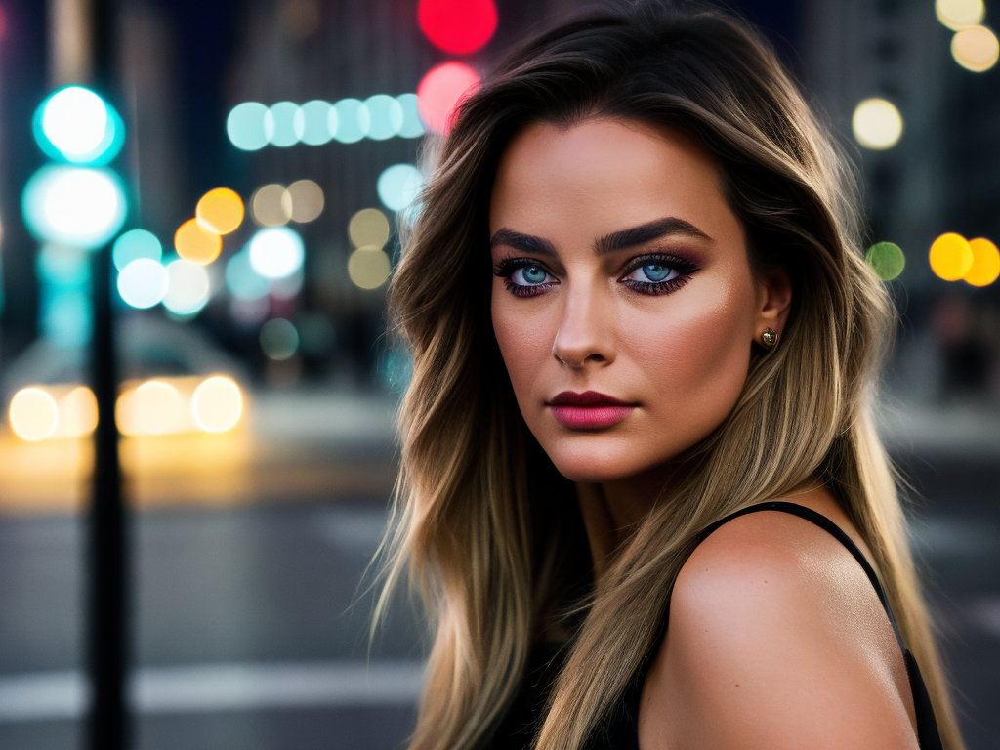

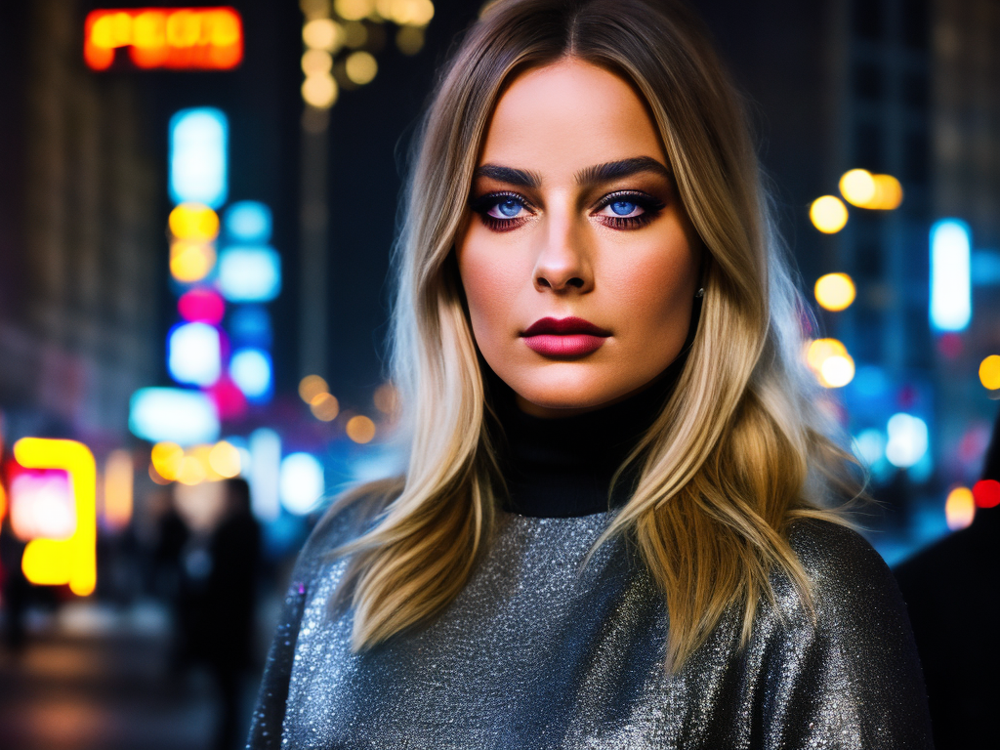

In [ ]:
prompt = "portrait of sks woman face, single, on the street, lights, midnight, NY, standing, raw, hd, high quality, realism, detailed light eyes"
negative_prompt = "naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands disconnected limbs, mutation, ugly, blurry, amputation"
num_samples = 2
guidance_scale = 7.5
num_inference_steps = 30
height = 768
width = 1024

with autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        negative_prompt=negative_prompt,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    ).images

for img in images:
    display(img)

In [ ]:
report_dir = 'LoRA_images/exp_9'
for i in range(len(images)):
    images[i].save(os.path.join(report_dir, f"{i}.jpg"))


# Compare Unet and LoRA

In [ ]:
from pathlib import Path
from glob import glob

In [ ]:
promt_list = [
    "portrait of sks woman face, in the kitchen, standing, raw, hd, high quality, realism, detailed eyes",
    "portrait of sks woman face, in the forest, standing, raw, hd, high quality, realism, detailed eyes",
    "portrait of sks woman face, on the street,  midnight, Tokio, standing, raw, hd, high quality, realism, sharp focus,  beautiful eyes, detailed eyes",
    "portrait of sks woman face, on the beach, day, sea, standing, raw, hd, high quality, realism, detailed eyes",
     "portrait of sks woman face, in the orthodox church, morning, standing, raw, hd, high quality, realism, detailed eyes"
]

from PIL import Image
def image_grid(imgs, rows, cols):
    assert len(imgs) == rows*cols

    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    grid_w, grid_h = grid.size

    for i, img in enumerate(imgs):
        grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

In [ ]:
def generate_im(pipe, given_prompt):
    with autocast("cuda"), torch.inference_mode():
        images = pipe(
        prompt = given_prompt,
        height=height,
        width=width,
        negative_prompt=negative_prompt,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    ).images
    return images

In [ ]:
g_cuda = torch.Generator(device='cuda')
seed = 345252
g_cuda.manual_seed(seed)
negative_prompt = "naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands disconnected limbs, mutation, ugly, blurry, amputation"
num_samples = 1
guidance_scale = 7.5
num_inference_steps = 30
height = 768
width = 1024

In [ ]:
model_path_sd = 'C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/civitai_model/dreambooth/experiment_2'
model_path_lora = 'C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/lora_exp/experiment_9'

In [ ]:
pipe_sd = StableDiffusionPipeline.from_pretrained(model_path_sd, safety_checker=None, torch_dtype=torch.float16).to("cuda")
pipe_sd.scheduler = DDIMScheduler.from_config(pipe_sd.scheduler.config)

pipe_lora = StableDiffusionPipeline.from_pretrained("C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/civitai_model", torch_dtype=torch.float16)
pipe_lora = pipe_lora.to("cuda")
pipe_lora.load_lora_weights(model_path_lora)


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [ ]:
for i in range(len(promt_list)):
    if not os.path.exists(f"prompt_images/prompt_{i+1}"):
        os.makedirs(f"prompt_images/prompt_{i+1}")
    images_sd = generate_im(pipe_sd, promt_list[i])
    images_lora = generate_im(pipe_lora, promt_list[i])
    images_sd[0].save(f"prompt_images/prompt_{i+1}/sd.jpg")
    images_lora[0].save(f"prompt_images/prompt_{i+1}/lora.jpg")

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

In [ ]:
images_lora = glob('prompt_images/*/lora.jpg')

In [ ]:
images_sd = glob('prompt_images/*/sd.jpg')

In [ ]:
images = [images_sd[0], images_lora[0], images_sd[1], images_lora[1], images_sd[2], images_lora[2],
         images_sd[3], images_lora[3], images_sd[4], images_lora[4]]

In [ ]:
images

In [ ]:
for i in range(10):
    images[i] = Image.open(images[i])

Выведем результаты генерации (слева - Unet, справа - LoRA)

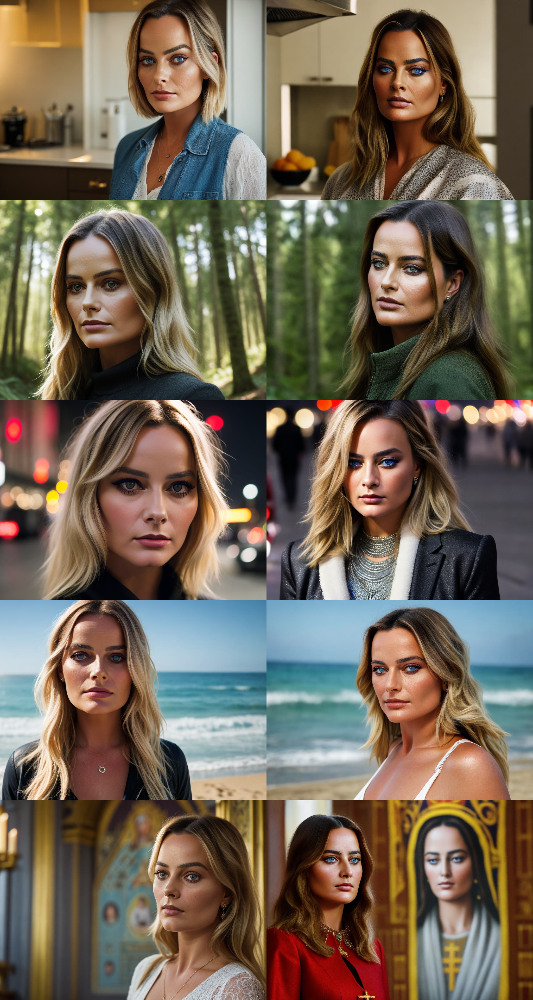

In [ ]:
image_grid(images, 5, 2)

# ControlNet

In [ ]:
from diffusers import StableDiffusionControlNetPipeline, ControlNetModel
from diffusers.utils import load_image
from diffusers import UniPCMultistepScheduler

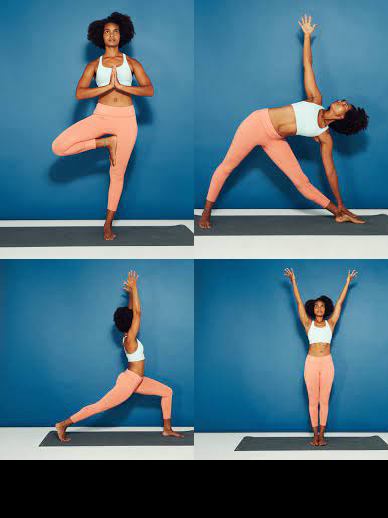

In [ ]:
urls = "yoga1.jpeg", "yoga2.jpeg", "yoga3.jpeg", "yoga4.jpeg"
imgs = [
    load_image("https://hf.co/datasets/YiYiXu/controlnet-testing/resolve/main/" + url)
    for url in urls
]

image_grid(imgs, 2, 2)

C:\anaconda\envs\pytorch-gpu-python-3-10\lib\site-packages\controlnet_aux\mediapipe_face\mediapipe_face_common.py:7: UserWarning: The module 'mediapipe' is not installed. The package will have limited functionality. Please install it using the command: pip install 'mediapipe'
  warnings.warn(


annotator/ckpts/body_pose_model.pth:   0%|          | 0.00/209M [00:00<?, ?B/s]

C:\anaconda\envs\pytorch-gpu-python-3-10\lib\site-packages\huggingface_hub\file_download.py:148: UserWarning: `huggingface_hub` cache-system uses symlinks by default to efficiently store duplicated files but your machine does not support them in C:\Users\Klim\.cache\huggingface\hub\models--lllyasviel--ControlNet. Caching files will still work but in a degraded version that might require more space on your disk. This warning can be disabled by setting the `HF_HUB_DISABLE_SYMLINKS_WARNING` environment variable. For more details, see https://huggingface.co/docs/huggingface_hub/how-to-cache#limitations.
To support symlinks on Windows, you either need to activate Developer Mode or to run Python as an administrator. In order to see activate developer mode, see this article: https://docs.microsoft.com/en-us/windows/apps/get-started/enable-your-device-for-development
  warnings.warn(message)


annotator/ckpts/hand_pose_model.pth:   0%|          | 0.00/147M [00:00<?, ?B/s]

facenet.pth:   0%|          | 0.00/154M [00:00<?, ?B/s]

C:\anaconda\envs\pytorch-gpu-python-3-10\lib\site-packages\huggingface_hub\file_download.py:148: UserWarning: `huggingface_hub` cache-system uses symlinks by default to efficiently store duplicated files but your machine does not support them in C:\Users\Klim\.cache\huggingface\hub\models--lllyasviel--Annotators. Caching files will still work but in a degraded version that might require more space on your disk. This warning can be disabled by setting the `HF_HUB_DISABLE_SYMLINKS_WARNING` environment variable. For more details, see https://huggingface.co/docs/huggingface_hub/how-to-cache#limitations.
To support symlinks on Windows, you either need to activate Developer Mode or to run Python as an administrator. In order to see activate developer mode, see this article: https://docs.microsoft.com/en-us/windows/apps/get-started/enable-your-device-for-development
  warnings.warn(message)


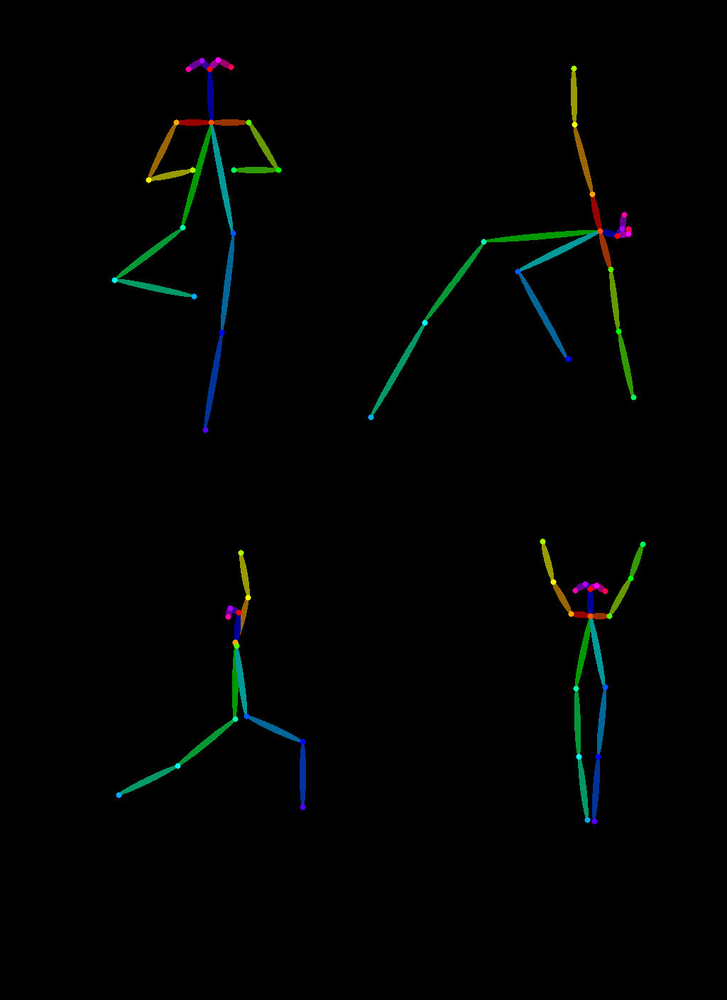

In [ ]:
from controlnet_aux import OpenposeDetector

model = OpenposeDetector.from_pretrained("lllyasviel/ControlNet")

poses = [model(img) for img in imgs]
image_grid(poses, 2, 2)

In [ ]:
model.to(device)

In [ ]:
model_path_sd = 'C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/civitai_model/dreambooth/experiment_2'
model_path_lora = 'C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/lora_exp/experiment_9'

## Unet

In [ ]:
controlnet = ControlNetModel.from_pretrained(
    "fusing/stable-diffusion-v1-5-controlnet-openpose", torch_dtype=torch.float16
)

pipe = StableDiffusionControlNetPipeline.from_pretrained(
    model_path_sd ,
    controlnet=controlnet,
    torch_dtype=torch.float16,
).to("cuda")
pipe.scheduler = UniPCMultistepScheduler.from_config(pipe.scheduler.config)

config.json:   0%|          | 0.00/920 [00:00<?, ?B/s]

C:\anaconda\envs\pytorch-gpu-python-3-10\lib\site-packages\huggingface_hub\file_download.py:148: UserWarning: `huggingface_hub` cache-system uses symlinks by default to efficiently store duplicated files but your machine does not support them in C:\Users\Klim\.cache\huggingface\hub\models--fusing--stable-diffusion-v1-5-controlnet-openpose. Caching files will still work but in a degraded version that might require more space on your disk. This warning can be disabled by setting the `HF_HUB_DISABLE_SYMLINKS_WARNING` environment variable. For more details, see https://huggingface.co/docs/huggingface_hub/how-to-cache#limitations.
To support symlinks on Windows, you either need to activate Developer Mode or to run Python as an administrator. In order to see activate developer mode, see this article: https://docs.microsoft.com/en-us/windows/apps/get-started/enable-your-device-for-development
  warnings.warn(message)


diffusion_pytorch_model.safetensors:   0%|          | 0.00/1.45G [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

C:\anaconda\envs\pytorch-gpu-python-3-10\lib\site-packages\transformers\models\clip\feature_extraction_clip.py:28: FutureWarning: The class CLIPFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use CLIPImageProcessor instead.
  warnings.warn(


  0%|          | 0/30 [00:00<?, ?it/s]

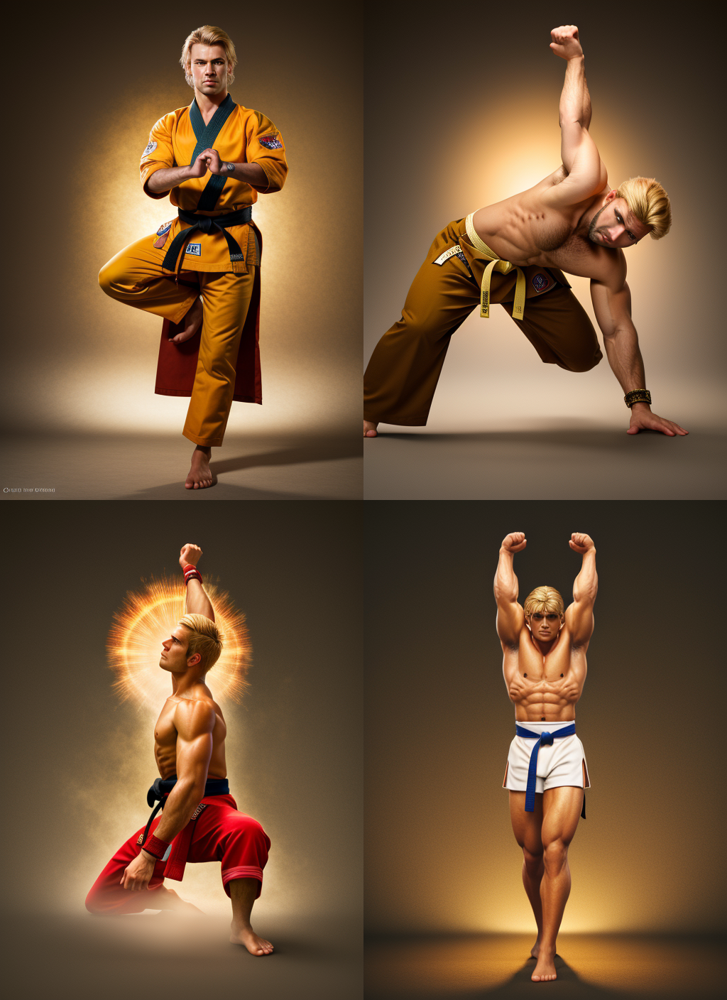

In [ ]:
generator = [torch.Generator(device="cuda").manual_seed(2) for i in range(4)]
prompt = "karate character, best quality, extremely detailed, detailed face, blonde european man, anatomically right hands"
output = pipe(
    [prompt] * 4,
    poses,
    negative_prompt=["monochrome, naked, lowres, naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands disconnected limbs, mutation, ugly, blurry, amputation"] * 4,
    generator=generator,
    num_inference_steps=30,

)
image_grid(output.images, 2, 2)

In [ ]:
report_dir = 'ControlNet/Unet'
for i in range(len(output['images'])):
    output['images'][i].save(os.path.join(report_dir, f"{i}.jpg"))


## LoRA

In [ ]:
pipe = StableDiffusionControlNetPipeline.from_pretrained(
    "C:/Users/Klim/Documents/Gen_models_HW_4/cache_dir/models/civitai_model",
    controlnet=controlnet,
    torch_dtype=torch.float16,
).to("cuda")
pipe.load_lora_weights(model_path_lora)
pipe.scheduler = UniPCMultistepScheduler.from_config(pipe.scheduler.config)

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

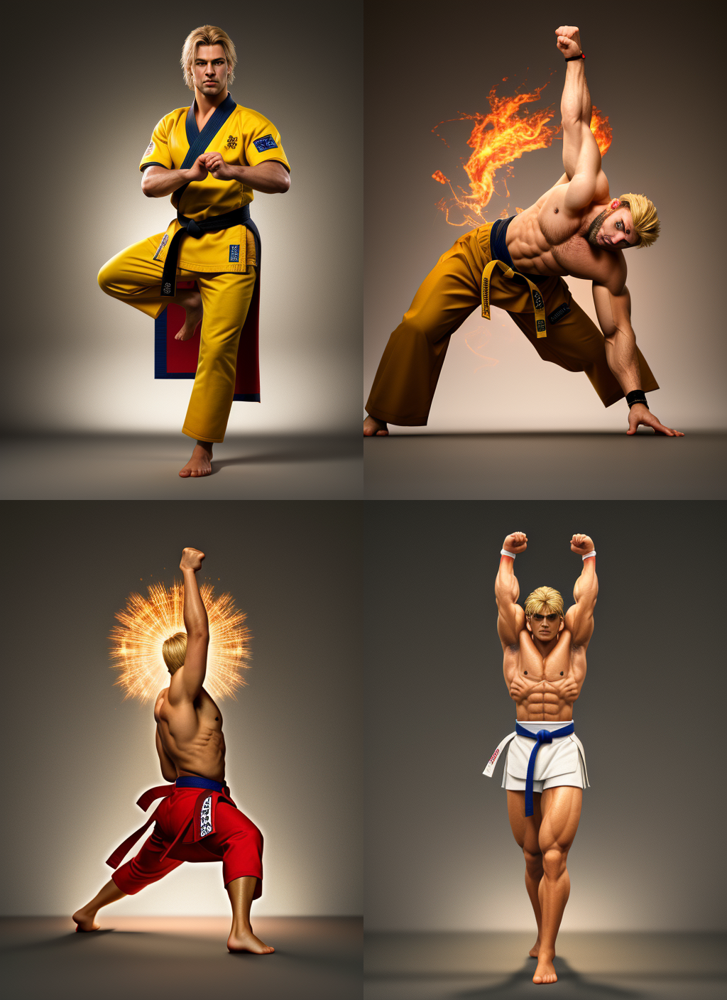

In [ ]:
generator = [torch.Generator(device="cuda").manual_seed(2) for i in range(4)]
prompt = "karate character, best quality, extremely detailed, detailed face, blonde european man, anatomically right hands"
output = pipe(
    [prompt] * 4,
    poses,
    negative_prompt=["monochrome, naked, lowres, naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands disconnected limbs, mutation, ugly, blurry, amputation"] * 4,
    generator=generator,
    num_inference_steps=30,

)
image_grid(output.images, 2, 2)

In [ ]:
report_dir = 'ControlNet/LoRA'
for i in range(len(output['images'])):
    output['images'][i].save(os.path.join(report_dir, f"{i}.jpg"))